In [1]:
import os 
import glob 
import pandas as pd
import geopandas as gpd
import uuid
from shapely.geometry import Point, box
import matplotlib.pyplot as plt
import seaborn as sns
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
from IPython.display import display
import folium

import warnings

# Ignore all warnings
warnings.filterwarnings("ignore")

plt.rc('text', usetex=True)
plt.rc('font', family='serif')
plt.rc('xtick',labelsize=12)
plt.rc('ytick',labelsize=12)

In [2]:
# def vectors_list(base_path: str, file_extension, region: str='All') -> list[str]:
#     ''' 
#     This function returns a list of paths to polygon files given base path and extension.

#     Arguments: (i) base_path - base directory containing all polygon files by region
#                (ii) file_extension - type of file being searched
#                (iii) region - region being searched; defaults to all regions

#     Returns: list of file paths
#     '''
#     if base_path.endswith("/"):
#         base_path = base_path[:-1]
#     if region == 'All':
#         return glob.glob(f"{base_path}/*/*.{file_extension}")
#     else:
#         return glob.glob(f"{base_path}/{region}/*.{file_extension}")

# def make_gdf(file_paths: list[str], export_gdf: bool=True) -> gpd.GeoDataFrame:
#     '''
#     This function converts the concatenated pandas dataframe into a
#     geopandas one by converting the WKT column into geometry. Additionally,
#     computes centroids and areas for each polygon. This is only for tile geometries
#     that were stored as csv files.

#     Arguments: (i) file_paths - a list of file paths to the csv files
#                (ii) export_gdf - a boolean tag for exporting geodataframe; defaults to True

#     Returns: returns a concated geodataframe containing all the tiles in the given region
#     '''
#     if not isinstance(file_paths, list):
#         raise ValueError(f"{file_paths} should be a list of file paths")

#     df_list = []
#     for file_path in file_paths:
#         if not os.path.exists(file_path):
#             raise FileNotFoundError(f"{file_path} cannot be found")
            
#         df = (
#             pd.read_csv(file_path)
#             .drop(columns=['value'])
#         )
#         if not 'uuid' in df.columns:
#             df['uuid'] = df.apply(lambda row: uuid.uuid4(), axis=1)
            
#         df = df[['uuid', 'geometry']]

#         # check if `region` and `tile_name` columns exist or not
#         if not pd.Series(['region', 'tile_name']).isin(df.columns).all():
#             region, file_name = (file_path.split('/')[1], file_path.split('/')[-1])
#             tile_name = file_name.split('_delineation')[0]

#             df.insert(loc=1, column='region', value=region)
#             df.insert(loc=2, column='tile_name', value=tile_name)

#         df_list.append(df)

#     df_joined = pd.concat(df_list)
#     geometry = gpd.GeoSeries.from_wkt(df_joined.geometry) 
#     gdf = gpd.GeoDataFrame(df_joined, geometry=geometry, crs='EPSG:4326')

#     #gdf['centroid'] = gdf.geometry.centroid 

#     geometry_pseudo_mercator = gdf.geometry.to_crs('EPSG:3857') # convert the polygons to physical distance units
#     gdf['area (sq. meters)'] = geometry_pseudo_mercator.area 
#     gdf['area (acres)'] = gdf['area (sq. meters)'] * 0.000247

#     ''' 
#     Each tile has one (or two) large polygons that are composed of background and
#     other field boundaries that were not identified. These are removed from each
#     tile.
#     '''
#     tile_names = gdf['tile_name'].unique()
#     idx_list = []
#     for tile in tile_names:
#         gdf_tile = gdf[gdf['tile_name']==tile]

#         max_area = gdf_tile['area (acres)'].max()
#         max_area_idx = gdf_tile[gdf_tile['area (acres)']==max_area].index[0]
#         idx_list.append(max_area_idx)

#     gdf = (
#         gdf.drop(index=idx_list)
#            .reset_index(drop=True)
#     )

#     if export_gdf:
#         gdf.to_file(f"vectors/{region}.gpkg", driver="GPKG")

#     return gdf

In [6]:
gdf_path_list = glob.glob("vectors/*.gpkg")

gdf_list = [gpd.read_file(path) for path in gdf_path_list]
gdf_all_regions = pd.concat(gdf_list)

## Polygon statistics

In [7]:
gdf_all_regions = gdf_all_regions.reset_index(drop=True)
gdf_all_regions

,uuid,region,tile_name,area (sq. meters),area (acres),geometry
0,3e5408f0-5018-42f0-8656-c2b9736e8b3b,Bomet_1,tile_1,25.153587,0.006213,"POLYGON ((35.28369 -0.80848, 35.28369 -0.80853..."
1,254ce499-8ef7-4dbf-8c48-cb2eeddbf020,Bomet_1,tile_1,25.153587,0.006213,"POLYGON ((35.28373 -0.80853, 35.28373 -0.80857..."
2,dd083637-ab3c-40f4-b34d-40414e6ff974,Bomet_1,tile_1,553.378916,0.136685,"POLYGON ((35.28373 -0.80848, 35.28373 -0.80853..."
3,447dce33-6ce0-41c9-8245-c67bb2c58aff,Bomet_1,tile_1,25.153587,0.006213,"POLYGON ((35.28405 -0.80857, 35.28405 -0.80862..."
4,11847306-f8b2-477b-ac2e-2b9754ea8401,Bomet_1,tile_1,679.146858,0.167749,"POLYGON ((35.27023 -0.80848, 35.27023 -0.80853..."
...,...,...,...,...,...,...
706085,a17bf933-e85c-4827-9b0e-5a4e5fc1b829,Machakos_1,tile_4,326.298758,0.080596,"POLYGON ((37.6002 -1.25751, 37.6002 -1.25755, ..."
706086,ab1a3b1d-0544-44e3-a79c-bc41e371c05b,Machakos_1,tile_4,74.741938,0.018461,"POLYGON ((37.63118 -1.25755, 37.63118 -1.2576,..."
706087,8823db21-ec5b-4668-b954-4c8f4a8b1826,Machakos_1,tile_4,225.899140,0.055797,"POLYGON ((37.63145 -1.25755, 37.63145 -1.2576,..."
706088,5427b2ea-2571-4aa3-8696-ad8871526b9b,Machakos_1,tile_4,25.099904,0.006200,"POLYGON ((37.63231 -1.25755, 37.63231 -1.2576,..."


In [8]:
print(f"Total number of unfiltered polygons: {gdf_all_regions.shape[0]}")

Total number of unfiltered polygons: 706090


We filter the data to remove very small and elongated areas from the dataset.

In [9]:
def filter_polygons(
        gdf: gpd.GeoDataFrame,
        min_area: float=0.1,
        elongation_thresh: float=150.0
) -> gpd.GeoDataFrame:
    
    gdf = gdf.copy()
    
    if gdf.crs is None:
        gdf = gdf.set_crs('epsg:4326')

    elongation = (gdf['geometry'].to_crs('EPSG:3587').length)**2 / gdf['area (sq. meters)']
    gdf['elongation'] = elongation
    gdf_filtered = gdf[
        (gdf['area (acres)'] >= min_area) &
        (gdf['elongation'] <= elongation_thresh)
    ]

    return gdf_filtered

In [10]:
gdf_filtered = filter_polygons(gdf_all_regions)

gdf_filtered

,uuid,region,tile_name,area (sq. meters),area (acres),geometry,elongation
2,dd083637-ab3c-40f4-b34d-40414e6ff974,Bomet_1,tile_1,553.378916,0.136685,"POLYGON ((35.28373 -0.80848, 35.28373 -0.80853...",45.878878
4,11847306-f8b2-477b-ac2e-2b9754ea8401,Bomet_1,tile_1,679.146858,0.167749,"POLYGON ((35.27023 -0.80848, 35.27023 -0.80853...",37.391604
7,578539b3-8b5f-4d24-bc42-d9144d4839a2,Bomet_1,tile_1,729.454033,0.180175,"POLYGON ((35.26574 -0.80848, 35.26574 -0.80857...",40.862681
8,195376f1-786a-49bf-b579-423f5ab8e12f,Bomet_1,tile_1,528.225333,0.130472,"POLYGON ((35.27462 -0.80848, 35.27462 -0.80853...",40.410076
9,7a29c217-a758-4d0b-9c21-2b48cfcf13e5,Bomet_1,tile_1,578.532507,0.142898,"POLYGON ((35.29558 -0.80848, 35.29558 -0.80853...",43.904787
...,...,...,...,...,...,...,...
706077,249b6c16-633d-463d-b002-572c65d8b59a,Machakos_1,tile_4,13921.457416,3.438600,"POLYGON ((37.62304 -1.25624, 37.62304 -1.25629...",43.134531
706078,df48b243-652f-418c-ab93-99e7e651fffd,Machakos_1,tile_4,2622.660988,0.647797,"POLYGON ((37.63258 -1.25728, 37.63258 -1.25742...",61.386107
706079,899bfe41-31f8-402c-9ae9-2173804c1116,Machakos_1,tile_4,3824.072237,0.944546,"POLYGON ((37.63815 -1.25687, 37.63815 -1.25692...",53.990715
706081,2df4f3f9-e1bf-4908-9008-48578183ff5a,Machakos_1,tile_4,16796.209052,4.148664,"POLYGON ((37.61176 -1.25669, 37.61176 -1.25674...",47.751310


The bars in red signify those regions for which a different parameter set was tried. The second parameter is better adept at segmenting smaller, blurrier fields. This is reflected in the much larger number of polygons present in the filtered data.

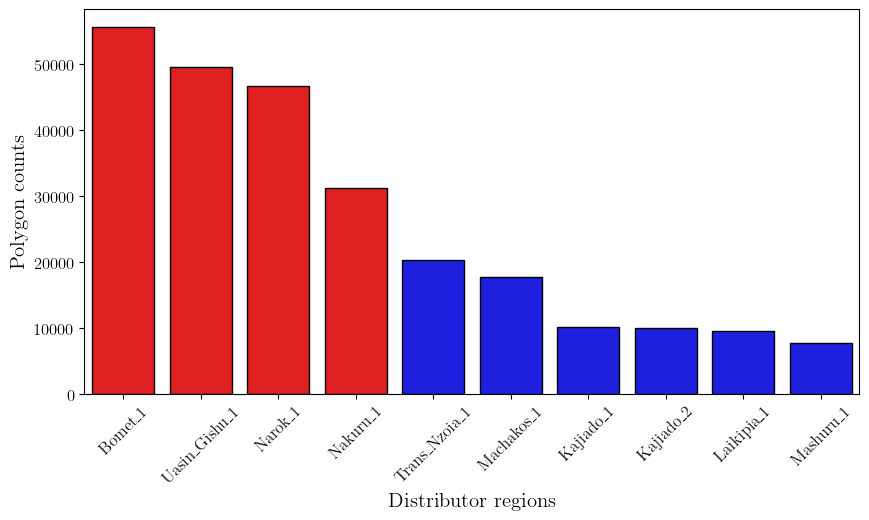

In [12]:
fig, ax = plt.subplots(figsize=(10, 5))

regions = gdf_filtered['region'].unique().tolist()

palette = {region: ('red' if region=='Bomet_1' or region=='Uasin_Gishu_1' or region=='Nakuru_1' or region=='Narok_1' else 'blue') for region in regions}

sns.countplot(gdf_filtered, x='region', 
              edgecolor='k', order=gdf_filtered['region'].value_counts().index, 
              palette=palette, ax=ax)
ax.tick_params(axis='x', labelrotation=45)
ax.set_xlabel('Distributor regions', fontsize=15)
ax.set_ylabel('Polygon counts', fontsize=15)
plt.show()

The polygons need to be manually inspected such that unwanted artifacts can be removed.

In [13]:
gdf_filtered[["region", "area (acres)"]].groupby("region").agg(["median", "std"])

area (acres)           
                    median        std
region                               
Bomet_1           0.292010   2.193266
Kajiado_1         0.578719  13.369683
Kajiado_2         0.486191   5.888499
Laikipia_1        0.602394  12.193581
Machakos_1        0.379810   2.879890
Mashuru_1         0.360855   7.962864
Nakuru_1          0.459268  12.298362
Narok_1           0.329300   3.005899
Trans_Nzoia_1     0.758198   6.488165
Uasin_Gishu_1     0.298502   1.176485

In [14]:
def plot_stats(region: str, type: str) -> None:
    gdf_region = gdf_filtered[gdf_filtered['region']==region]

    fig, ax = plt.subplots(figsize=(8, 5))

    if type == 'histogram':
        sns.histplot(gdf_region, x='area (acres)', bins=50, edgecolor='k', ax=ax)
        ax.set_xlabel(f'Polygons: {region}', fontsize=15)
        ax.set_ylabel('Frequency', fontsize=15)
        ax.set_yscale('log')

        plt.show()
        
    elif type == 'box':
        sns.boxplot(gdf_filtered, y='region', x='area (acres)', hue='region', ax=ax)
        ax.set_xlabel('Polygon area (acres)', fontsize=15)
        ax.set_ylabel('Distributor regions', fontsize=15)
        ax.set_xscale('log')

        plt.show()

The Trans Nzoia region was the easiest to segment, owing to the relatively larger fields and better image contrast.

In [15]:
region_dropdown = widgets.Dropdown(
    options=regions
)
plot_type_dropdown = widgets.ToggleButtons(options=['histogram', 'box'])
ui = widgets.HBox([region_dropdown, plot_type_dropdown])

output = widgets.interactive_output(
    plot_stats, {'region': region_dropdown, 'type': plot_type_dropdown}
)
display(ui, output)

Output()

## Combining sales and leads data

A subset of the leads data contains longitude and latitude information, which can be used to calculate the proportion of leads falling inside the generated polygons.

In [16]:
# Importing cleaned sales and leads data

df_sales = pd.read_csv("../data/sales_and_leads/sales_clean_20250131.csv")
df_leads = pd.read_csv("../data/sales_and_leads/leads_clean_20250131.csv")

In [17]:
df_leads = df_leads[df_leads["Final Lat"].notna()]

df_leads.head()

,Farmer Code,Sales manager area,Gender,Total farm size,Sub-County,Full potential (ton / yr),Farm Potential Category,Problem / Opportunity of Farmer,Crop 1,Acres for crop 1,Crop 2,Acres for crop 2,Crop 3,Acres for crop 3,Lead From?,Final Lat,Final Long,Prioritization
5,6,Kimana,Male,15.0,Ndempesi,NaN,NaN,High Soil Acidity,tomatoes,15.0,NaN,NaN,NaN,NaN,NaN,-2.771022,37.534941,NaN
17,18,Kimana,Male,30.0,Rombo,NaN,NaN,Soil Fertility Restoration,tomatoes,30.0,NaN,NaN,NaN,NaN,NaN,-3.164146,37.718301,NaN
20,21,Kimana,Male,10.0,Kimana,NaN,NaN,High Soil Acidity,tomatoes,10.0,NaN,NaN,NaN,NaN,event,-2.773471,37.559099,NaN
27,28,Kimana,Male,12.0,Ndempesi,NaN,NaN,High Soil Acidity,tomatoes,15.0,NaN,NaN,NaN,NaN,NaN,-2.770870,37.539793,NaN
31,32,Kimana,Male,20.0,Kimana,NaN,NaN,Soil Fertility Restoration,tomatoes,10.0,onions,10.0,NaN,NaN,event,-2.782365,37.555766,NaN


In [18]:
df_leads.shape

(331, 18)

There are 331 leads entries with longitude/latitude information. We can use a spatial join to check how many of them are contained within the polygons generated.

In [19]:
gdf_leads =gpd.GeoDataFrame(
    df_leads, geometry=gpd.points_from_xy(df_leads["Final Long"], df_leads["Final Lat"], crs="EPSG:4326")
)

gdf_sjoined = gpd.sjoin(
    left_df=gdf_filtered,
    right_df=gdf_leads,
    how='inner',
    predicate='contains'
)

print(f"Number of leads data points contained in generated polygons: {gdf_sjoined.shape[0]}")

Number of leads data points contained in generated polygons: 37


Only 11% of the leads data points are contained within the polygons generated. There are many possible reasons why this may happen. We know that `segment-geospatial` does not segment all field polygons, which can be exacerbated by resolution issues. Moreover, many polygons may not be contained within the region surveyed.

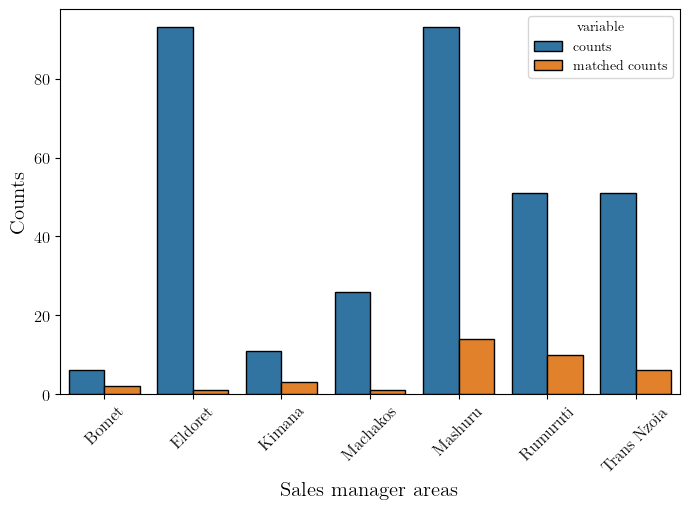

In [20]:
def plot_matches(df: pd.DataFrame, gdf: gpd.GeoDataFrame) -> None:
    mapping_dict = dict(zip(gdf["Sales manager area"], gdf["region"]))

    leads_agg = df.groupby("Sales manager area").count().reset_index()
    col1 = leads_agg["Sales manager area"]
    col2 = leads_agg["Farmer Code"]

    leads_count = pd.DataFrame({"Sales manager area": col1, "counts": col2})
    
    leads_matched = gdf.groupby("Sales manager area").agg("count").reset_index()
    counts_matched = leads_matched["Farmer Code"]
    leads_count["matched counts"] = counts_matched

    leads_count["region"] = leads_count["Sales manager area"].map(mapping_dict)

    leads_melted = pd.melt(
        leads_count, id_vars="Sales manager area", value_vars=["counts", "matched counts"]
    )

    fig, ax = plt.subplots(figsize=(8, 5))
    sns.barplot(leads_melted, x="Sales manager area", y="value", hue="variable", edgecolor='k', ax=ax)
    ax.tick_params(axis='x', labelrotation=45)
    ax.set_xlabel('Sales manager areas', fontsize=15)
    ax.set_ylabel('Counts', fontsize=15)
    plt.show()

plot_matches(df_leads, gdf_sjoined)

In [21]:
def plot_polygons(
        gdf_polygon: gpd.GeoDataFrame,
        gdf_leads: gpd.GeoDataFrame,
        region: str 
) -> None:
    
    gdf_region = gdf_polygon[gdf_polygon["region"]==region]
    
    # Get bounds of the region
    xmin, ymin, xmax, ymax = gdf_region.total_bounds

    # Filter leads gdf to the region bounds
    gdf_leads_bounded = gdf_leads.cx[xmin:xmax, ymin:ymax]

    m = gdf_region.explore(name=region)
    gdf_leads_bounded.explore(
        m=m,
        color="red",
        marker_kwds=dict(radius=5, fill=True)
        )
    display(m)

In [165]:
plot_polygons(gdf_filtered, gdf_leads, "Trans_Nzoia_1")